## Capstone Project - Predicting Location of A New Asian Restaurant in Southwest Houston, TX

### Applied Data Science Capstone by IBM/Coursera

by Deming Wang

11/20/2020

Python 3.6

## Table of contents

#### - I Introduction: Business Problem
#### - II Data
#### - III Methodology
#### - IV Results
#### - V Discussion
#### - VI Conclusion
#### - References
#### - Project link in GitHub


## I Introduction: Business Problem

In this project, I will try to analyze restaurant distribution in west Hoston area including Kay, Sugar Land and Misourri City. This report will target to stakeholders who are interested in opening an Asian restaurant in Sugar Land, TX.

Sugar Land is located in great Houston metropolitan area in Texas. Both cities are mostly in Fort Bend County with lots of active business. There are lots of different types of restaurants and we will try to see how these restaurants distributed in west Houston and find out the best possible locations for a new Asian restaurant in Sugar Land.

## II Data

Based on definition of our problem, the following factors are key answers to our problem:

- All existing restaurants in west Houston
- Locations of these restaurants
- Food type (category) of all restaurants: for example, Asian restaurant, Mexican restaurant, Cafe, etc.

It is possible to get all restaurants for each neighborhood, but many neighborhoods are in irregular shapes and it is hard to use neighborhood center to search restaurants. To have better coverage, many small cycles will be created in selected area, then restaurants will be searched via Foursquare API based on center of each area. The following data will be needed to extract/generate the required restaurant information:

- coordinates of the center in both cities using folium map.
- generate small areas in folium map
- retrieve all restaurants for each area using Foursquare API

The following code are steps to retrieve and prepare data.

Install missing packages and import selected modules

In [1]:
# install packages required by this project
!pip install folium
!pip install bs4 
!pip install geopy
!pip install lxml
!pip install shapely
print("Packages installed")

Packages installed


In [2]:
# import packages
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt
import folium
%matplotlib inline
from sklearn.cluster import KMeans
import requests
from bs4 import BeautifulSoup
from geopy.geocoders import Nominatim
import lxml
import shapely.geometry
import pyproj
import math
print("Packages Imported")

Packages Imported


To accurately calculate distance between two points, the geodetic coordinates(latitude and longitude) need to be converted to projected coordinates (x and y) using WGS84 datum. The following functions are defined for coordinates convertion and distance calculation.

In [3]:
def lonlat_to_xy(lon, lat):
# Convert Latitude, and Longitude to project coordinates x,y in WGS84 Geographycial Datum
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    xy = pyproj.transform(proj_latlon, proj_xy, lon, lat)
    return xy[0], xy[1]

def xy_to_lonlat(x, y):
# Convert project coordinates x,y to Latitude, and Longitude in WGS84 Geographycial Datum
    proj_latlon = pyproj.Proj(proj='latlong',datum='WGS84')
    proj_xy = pyproj.Proj(proj="utm", zone=33, datum='WGS84')
    lonlat = pyproj.transform(proj_xy, proj_latlon, x, y)
    return lonlat[0], lonlat[1]

def calc_xy_distance(x1, y1, x2, y2):
# Calculate distance between two points in projected coordinate system. 
# This method cann't be used for lattitude/longitude
    dx = x2 - x1
    dy = y2 - y1
    return math.sqrt(dx*dx + dy*dy)

Generate location points around point (29.6589382, -95.7276974). This will create a hexagonal grid of cells: offset is applied to every other row, and vertical row spacing is adjusted so that every cell center is equally distant from all it's neighbors.

In [4]:
def generate_locations(center_lat, center_lng):  
# center location of my working area

    center_x, center_y = lonlat_to_xy(center_lng, center_lat) # Convert to projected x,y
    k = math.sqrt(3) / 2 # Vertical offset for hexagonal grid cells
    x_min = center_x - 38000
    x_step = 1800
    y_min = center_y - 38000 - (int(21/k)*k*600 - 38000)/3
    y_step = 1800 * k 

    latitudes = []
    longitudes = []
    distances_from_center = []
    xs = []
    ys = []
    for i in range(0, int(21/k*3)):
        y = y_min + i * y_step
        x_offset = 300 if i%2==0 else 0
        for j in range(0, 63):
            x = x_min + j * x_step + x_offset
            distance_from_center = calc_xy_distance(center_x, center_y, x, y)
            if (distance_from_center <= 38001):
                lon, lat = xy_to_lonlat(x, y)
                latitudes.append(lat)
                longitudes.append(lon)
                distances_from_center.append(distance_from_center)
                xs.append(x)
                ys.append(y)

    print(len(latitudes), 'candidate area centers generated.')            
    df_locations = pd.DataFrame({'Latitude': latitudes,'Longitude': longitudes})
    df_locations.head()
    return df_locations

center_lat = 29.6589382
center_lng = -95.7276974
df_locations = generate_locations(center_lat, center_lng)
df_locations.head(2)

1534 candidate area centers generated.


,Latitude,Longitude
0,29.654315,-95.501521
1,29.661882,-95.508004


Now we have the coordinates of centers of areas to be evaluated, equally spaced (distance from every point to it's neighbors is exactly the same). The following map shows all points and coverage of each point.

In [5]:
#display all points and cycles(radius = 600)
map = folium.Map(location=[center_lat, center_lng], zoom_start=11)
for lat,lng in zip(df_locations['Latitude'], df_locations['Longitude']):
    folium.Circle([lat, lng], radius=600, color='blue', fill=False).add_to(map)
    folium.CircleMarker(
        [lat,lng],
        radius=2,
        popup='',
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.7,
        parse_html=False).add_to(map)
map

Save generated locations to locations.pkl file

In [6]:
# save df_locations
#df_locations.to_pickle('./locations.pkl')

In [7]:
# read df_locations
df_locations = pd.read_pickle('./locations.pkl')
df_locations.shape

(1534, 2)

Define foursquare API id, secret, and api version

In [8]:
f=open("./FourSquareAPI.txt","r")
lines=f.readlines()
CLIENT_ID=lines[0]
CLIENT_SECRET=lines[1]
VERSION = lines[2]
f.close()

According to foursquare API documentation(https://developer.foursquare.com/docs/build-with-foursquare/categories/), all restaurant categories are listed under category - Food with id  4d4b7105d754a06374d81259.

The following code will retrieve all food categories from foursquare

In [9]:
food_category = '4d4b7105d754a06374d81259'

In [10]:
def foursquare_food_categories():
# retrieve food categories from foursquare
    url = 'https://api.foursquare.com/v2/venues/categories?client_id={}&client_secret={}&v={}'.format(
        CLIENT_ID, CLIENT_SECRET, VERSION)
    try:
        results = requests.get(url).json()['response']['categories']
        categories = {}
        for cat in results:
            if cat['name'] == "Food":
                for foodcat in cat['categories']:
                    if (foodcat['name'] in categories):
                        print(foodcat['name'] + ' skip')
                    else:
                        #print(foodcat['name'] + ' append')
                        categories[foodcat['name']] = [foodcat['id']]
                        
                    for countrycat in foodcat['categories']:
                        #print("--->" + countrycat['name'])
                        categories[foodcat['name']].append(countrycat['id'])
                        for statecat in countrycat['categories']:
                            #print("   --->" + statecat['name'])
                            categories[foodcat['name']].append(statecat['id'])
                            for xcat in statecat['categories']:
                                #print("      -------------------->" + xcat['name'])                   
                                categories[foodcat['name']].append(xcat['id'])
                    
    except Exception as e:
        print("exception captured")
        print(e)
        categories = {}
    return categories

In [11]:
categories = foursquare_food_categories()
for key in categories:
    print(key,end='')

Afghan RestaurantAfrican RestaurantAmerican RestaurantArmenian RestaurantAsian RestaurantAustralian RestaurantAustrian RestaurantBBQ JointBagel ShopBakeryBangladeshi RestaurantBelgian RestaurantBistroBreakfast SpotBubble Tea ShopBuffetBurger JointCafeteriaCaféCajun / Creole RestaurantCaribbean RestaurantCaucasian RestaurantCoffee ShopComfort Food RestaurantCreperieCzech RestaurantDeli / BodegaDessert ShopDinerDonut ShopDumpling RestaurantDutch RestaurantEastern European RestaurantEnglish RestaurantFalafel RestaurantFast Food RestaurantFish & Chips ShopFondue RestaurantFood CourtFood StandFood TruckFrench RestaurantFried Chicken JointFriterieGastropubGerman RestaurantGluten-free RestaurantGreek RestaurantHalal RestaurantHawaiian RestaurantHot Dog JointHungarian RestaurantIndian RestaurantIrish PubItalian RestaurantJewish RestaurantJuice BarKebab RestaurantLatin American RestaurantMac & Cheese JointMediterranean RestaurantMexican RestaurantMiddle Eastern RestaurantModern European Restaur

In [12]:
df_locations['Area'] = df_locations.index
df_locations.head(2)

,Latitude,Longitude,Area
0,29.654315,-95.501521,0
1,29.661882,-95.508004,1


Now we have all locations and we can use Foursquare API to get restaurants for each location.

We will use Foursquare api id, secret, version, location and redius(default 600 meters) to generate REST api query string and reformat response data to restaurants list.

In [13]:
def get_categories(categories):
    return [(cat['name'], cat['id']) for cat in categories]

def format_address(location):
    address = ', '.join(location['formattedAddress'])
    return address

def get_venues_near_location(lat, lon, category, client_id, client_secret, version, radius=600, limit=100):
    url = 'https://api.foursquare.com/v2/venues/explore?client_id={}&client_secret={}&v={}&ll={},{}&categoryId={}&radius={}&limit={}'.format(
        client_id, client_secret, version, lat, lon, category, radius, limit)
    try:
        results = requests.get(url).json()['response']['groups'][0]['items']
        venues = [(item['venue']['id'],
                   item['venue']['name'],
                   get_categories(item['venue']['categories']),
                   (item['venue']['location']['lat'], item['venue']['location']['lng']),
                   format_address(item['venue']['location']),
                   item['venue']['location']['distance']) for item in results]        
    except:
        print("[E]",end=',')
        #print(url)
        venues = []
    return venues

def get_restaurants(lats, lons):
    restaurants = {}
    location_restaurants = []

    #print('Obtaining venues around candidate locations:', end='')
    for lat, lon in zip(lats, lons):
        venues = get_venues_near_location(lat, lon, food_category, CLIENT_ID, CLIENT_SECRET, VERSION, radius=600, limit=100)
        area_restaurants = []
        for venue in venues:
            venue_id = venue[0]
            venue_name = venue[1]
            venue_categories = venue[2]
            venue_latlon = venue[3]
            venue_address = venue[4]
            venue_distance = venue[5]
            
            #is_res, is_italian = is_restaurant(venue_categories)
            venue_category = ""
            for cat in categories:
                if venue_categories[0][1] in categories[cat]:
                    venue_category = cat
                    break
            #print(venue_name + ":" + venue_category)
            x, y = lonlat_to_xy(venue_latlon[1], venue_latlon[0])
            restaurant = (venue_id, venue_name, venue_latlon[0], venue_latlon[1], venue_address, venue_distance, venue_category, x, y)
            area_restaurants.append(restaurant)
            restaurants[venue_id] = restaurant
                
        location_restaurants.append(area_restaurants)
        #print('.', end='')
    return restaurants

Since there are limits from Foursquare website, we can run get_restaurants_from_locations function multiple times if needed. start_index and end_index can be adjusted to request for specific locations.

In [14]:
data = []

In [15]:
def get_restaurants_from_locations(df_locations, start_index=0, end_index = 1535):
    for index, row in df_locations.iterrows():
        if index < start_index:
            continue
        if index >= end_index:
            break
        print(index, end=',')      
        restaurants = get_restaurants([row['Latitude']],[row['Longitude']])
        for key in restaurants:
            res = restaurants[key]
            data.append(["Area_" + str(int(row['Area'])), row['Latitude'],row['Longitude'], res[0], res[1], res[2], res[3], res[6], res[5], res[4]])
              
    print(len(data), " restaurants retrieved")    
    return

In [16]:
get_restaurants_from_locations(df_locations,1536)

0  restaurants retrieved


Finally, there are 3702 restaurants info retrieved and the distrubtion can be visualized on map.

In [17]:
#df = pd.DataFrame(data, columns=("area","area_lat", "area_lng", "id", "name","lat","lng", "category", "distance","address"))
#df.to_pickle('./df.pkl')
df = pd.read_pickle('./df.pkl')
df.head()

,area,area_lat,area_lng,id,name,lat,lng,category,distance,address
0,Area_0,29.654315,-95.501521,4c1e4415fcf8c9b671f3ac0b,Teotihuacan Mexican Cafe,29.655483,-95.506624,Mexican Restaurant,510,"6579 W Bellfort St (at Larkwood Dr.), Houston,..."
1,Area_0,29.654315,-95.501521,4f32176c19836c91c7b4ef20,Las Delicias Taqueria,29.657900,-95.497726,,542,"11131 Albury Dr, Houston, TX 77096, United States"
2,Area_1,29.661882,-95.508004,4c4dd1d3db2c20a187257773,SUBWAY,29.659416,-95.508951,Sandwich Place,289,"11096 Fondren Rd, Houston, TX 77096, United St..."
3,Area_1,29.661882,-95.508004,4c005ae78c1076b0e5062071,Church's Chicken,29.658260,-95.508123,Fried Chicken Joint,403,"11121 Fondren Rd, Houston, TX 77096, United St..."
4,Area_1,29.661882,-95.508004,4cd4503c122ba143d4a024a1,Little Caesars Pizza,29.659060,-95.508046,Pizza Place,314,"11101 Fondren Fondren Southwest Village, Houst..."


In [18]:
map = folium.Map(location=[center_lat, center_lng],zoom_start=13, height=500)
for lat,lng,name,area in zip(df['lat'], df['lng'], df['name'],df['area']):
    label = '{}-{}'.format(area,name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat,lng],
        radius = 2,
        popup = label,
        color= 'red',
        fill = True,
        fill_color = 'red',
        fill_opacity = 0.7,
        parse_html = False).add_to(map)
map

To make clustering algorithem more efficient later, we'll combine some categories into "Fast Food Restaurant","Cafe", and "Pub".

In [19]:
df.loc[(df.category == ''),'category']='Food'
df.loc[(df.category == 'Sandwich Place'),'category']='Fastfood'
df.loc[(df.category == 'Fried Chicken Joint'),'category']='Fastfood' 
df.loc[(df.category == 'Pizza Place'),'category']='Fastfood'
df.loc[(df.category == 'BBQ Joint'),'category']='Cafe'
df.loc[(df.category == 'Breakfast Spot'),'category']='Fastfood'
df.loc[(df.category == 'Donut Shop'),'category']='Fastfood'
df.loc[(df.category == 'Food Truck'),'category']='Fastfood'
df.loc[(df.category == 'Bakery'),'category']='Fastfood'
df.loc[(df.category == 'Buffet'),'category']='Cafe'
df.loc[(df.category == 'Café'),'category']='Cafe'
df.loc[(df.category == 'Burger Joint'),'category']= 'Fastfood'
df.loc[(df.category == 'Deli / Bodega'),'category']='Cafe'
df.loc[(df.category == 'Steakhouse'),'category']='Cafe'
df.loc[(df.category == 'Salad Place'),'category']='Cafe'
df.loc[(df.category == 'Bistro'),'category']='Fastfood'
df.loc[(df.category == 'Wings Joint'),'category']='Fastfood'
df.loc[(df.category == 'Bagel Shop'),'category']='Fastfood'
df.loc[(df.category == 'Cafeteria'),'category']='Cafe'
df.loc[(df.category == 'Diner'),'category']='Cafe'
df.loc[(df.category == 'Gastropub'),'category']='Pub'
df.loc[(df.category == 'Snack Place'),'category']= 'Fastfood'
df.loc[(df.category == 'Food Court'),'category']='Cafe'
df.loc[(df.category == 'Soup Place'),'category']='Cafe'
df.loc[(df.category == 'Hot Dog Joint'),'category']='Fastfood'
df.loc[(df.category == 'Irish Pub'),'category']='Pub'
df.loc[(df.category == 'Creperie'),'category']='Cafe'
df.loc[(df.category == 'Fish & Chips Shop'),'category']='Fastfood'
df.loc[(df.category == 'Mac & Cheese Joint'),'category']='Fastfood'
df.loc[(df.category == 'Fastfood'),'category']='Fast Food Restaurant'

In [20]:
len(df['category'].unique())

41

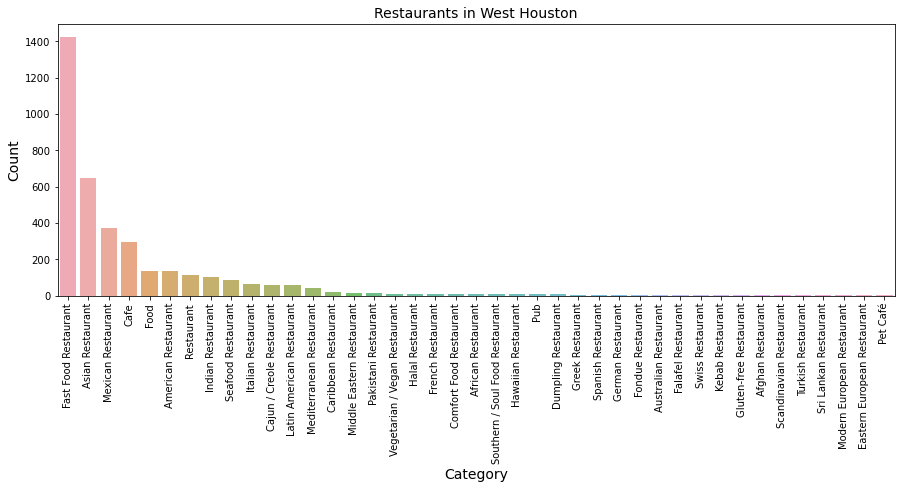

In [21]:
import seaborn as sns
def restaurants_per_category_plot():
    # Plotting a bar graph of the number of restaurants in each category
    category_count  = df['category'].value_counts()
    category_count = category_count[:41,]
    plt.figure(figsize=(15,5))
    sns.barplot(category_count.index, category_count.values, alpha=0.8)
    plt.title('Restaurants in West Houston',fontsize=14)
    plt.ylabel('Count', fontsize=14)
    plt.xlabel('Category', fontsize=14)
    plt.xticks(rotation=90)
    plt.show()
    
restaurants_per_category_plot()    

So now, we have all restaurants in west Houston area and each restaurant has location and category information. This concludes the data preparation phase, and these data will be used later for advanced analysis.

## III Methology

In this project I will direct our efforts on detecting areas in Sugar Land that have high Aisan restaurant density and similar restaurant distribution as Houston China town and Katy Asian town.

The whole area will be devided into NxN grid, and use K-Means to create clusters of restaurant categories. 

First, we'll try to run a test with N=18, and run K-Means up to 30 clusters.

In [22]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import MinMaxScaler
def TryN(n):
    print("N =",n)
    
    x_min = df['lng'].min()
    x_max = df['lng'].max()
    y_min = df['lat'].min()
    y_max = df['lat'].max()
    x_step = (x_max - x_min)/n
    y_step = (y_max - y_min)/n
    #print(x_min, x_max, y_min, y_max, x_step, y_step)
    df['square_x'] = (df['lng'] - x_min)/x_step
    df['square_x'] = df['square_x'].astype(int)
    df['square_y'] = (df['lat'] - y_min)/y_step
    df['square_y'] = df['square_y'].astype(int)
    df['square'] = df['square_x'] + (df['square_y']*n)
    
    #df_restaurants = df[df.category.str.contains("Restaurant")]
    df_restaurants = df
    #df_restaurants.head()
    onehot = pd.get_dummies(df_restaurants[['category']], prefix="", prefix_sep="")
    onehot.insert(loc=0, column='Area', value=df['square'] )
    grouped = onehot.groupby('Area').mean().reset_index()

    grouped_clustering = grouped.drop('Area', 1)
    #mms = MinMaxScaler()
    #mms.fit(grouped_clustering.astype(np.float))
    #data_transformed = mms.transform(grouped_clustering)

    Sum_of_squared_distances = []
    sil = []
    K = range(2,30)
    for k in K:
        km = KMeans(n_clusters=k, random_state=0)
        km = km.fit(grouped_clustering)
        Sum_of_squared_distances.append(km.inertia_)
        sil.append(silhouette_score(grouped_clustering, km.labels_, metric = 'euclidean'))
        print('.', end='')  
    print("Done") 
    return n, K, Sum_of_squared_distances, sil

In [23]:
Score18 = TryN(18)

N = 18
............................Done


The following plot shows the results and there is no clear trend to identify a optimal K value. So silhouette score is selected to identify the optimal K. Although K=8 has the highest score, but the score is only near 0.31, 

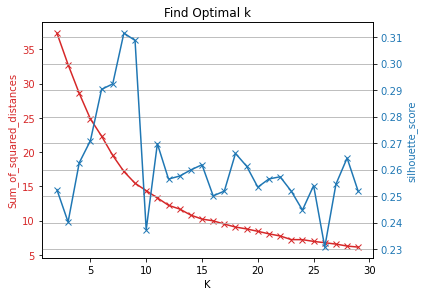

In [24]:
K = range(2,30)
fig, ax1 = plt.subplots()
color = 'tab:red'
ax1.set_xlabel('K')
ax1.set_ylabel('Sum_of_squared_distances', color=color)
ax1.plot(K, Score18[2], color=color, marker='x')
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('silhouette_score', color=color)  # we already handled the x-label with ax1
ax2.plot(K, Score18[3], color=color, marker='x')
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.title('Find Optimal k')
plt.grid(True)
plt.show()

To find the optimal K, we'll run an uncertainty analysis for grid size and generate scenarios for N from 10 to 70.

In [25]:
Score10 = TryN(10)
Score15 = TryN(15)
Score20 = TryN(20)
Score25 = TryN(25)
Score30 = TryN(30)
Score35 = TryN(35)
Score40 = TryN(40)
Score45 = TryN(45)
Score50 = TryN(50)
Score55 = TryN(55)
Score60 = TryN(60)
Score65 = TryN(65)
Score70 = TryN(70)

N = 10
............................Done
N = 15
............................Done
N = 20
............................Done
N = 25
............................Done
N = 30
............................Done
N = 35
............................Done
N = 40
............................Done
N = 45
............................Done
N = 50
............................Done
N = 55
............................Done
N = 60
............................Done
N = 65
............................Done
N = 70
............................Done


The following plot shows there are no clear elbow method can be used to identify optimal K, but silhouette score line get higher as N increases.

We would like to choose a N value with high silhouette score and keep K as small as possible. From the plot, N=65 and K=20 seems acceptable.

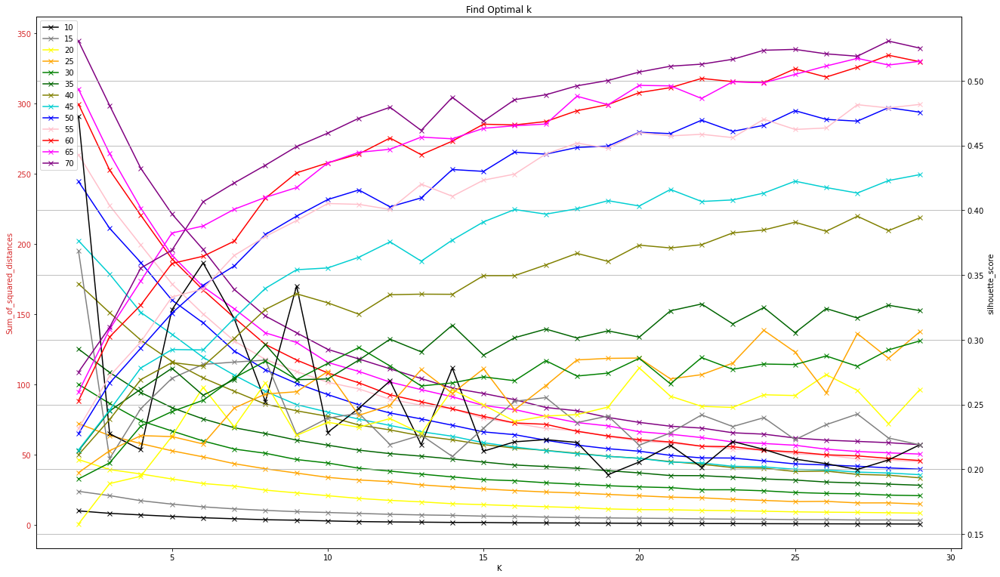

In [26]:
# Plot Sum_of_squared_distance and silhouette_score for different Ns in one single plot for comparison

K = Score10[1]
n = [10,15,20,25,30,35,40,45,50,55,60,65,70]
data_ssd = [Score10[2],Score15[2],Score20[2],Score25[2],Score30[2],Score35[2],Score40[2],Score45[2],Score50[2],Score55[2],Score60[2],Score65[2],Score70[2]]
data_sil = [Score10[3],Score15[3],Score20[3],Score25[3],Score30[3],Score35[3],Score40[3],Score45[3],Score50[3],Score55[3],Score60[3],Score65[3],Score70[3]]
colors = ['black','gray','yellow','orange','green','darkgreen','olive','darkturquoise','blue','pink', 'red','magenta','purple']

fig, ax1 = plt.subplots()
fig.set_size_inches(18.5, 10.5)
color = 'tab:red'
ax1.set_xlabel('K')
ax1.set_ylabel('Sum_of_squared_distances', color=color)
for i in range(0, len(n)):
    ax1.plot(K, data_ssd[i], color=colors[i], marker='x', label=n[i])
ax1.tick_params(axis='y', labelcolor=color)
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax2.set_ylabel('silhouette_score', color='black')  # we already handled the x-label with ax1
for i in range(0, len(n)):
    ax2.plot(K, data_sil[i], color=colors[i], marker='x', label=n[i])
ax2.tick_params(axis='y', labelcolor='black')
fig.tight_layout()  # otherwise the right y-label is slightly clipped
    
plt.title('Find Optimal k')
plt.grid(True)
plt.legend(n, loc='upper left')
plt.show()

In [27]:
#select n= 65
    n = 65

    x_min = df['lng'].min()
    x_max = df['lng'].max()
    y_min = df['lat'].min()
    y_max = df['lat'].max()
    x_step = (x_max - x_min)/n
    y_step = (y_max - y_min)/n
    #print(x_min, x_max, y_min, y_max, x_step, y_step)
    df['square_x'] = (df['lng'] - x_min)/x_step
    df['square_x'] = df['square_x'].astype(int)
    df['square_y'] = (df['lat'] - y_min)/y_step
    df['square_y'] = df['square_y'].astype(int)
    df['square'] = df['square_x'] + (df['square_y']*n)
    
    #df_restaurants = df[df.category.str.contains("Restaurant")]
    df_restaurants = df
    #df_restaurants.head()
    onehot = pd.get_dummies(df_restaurants[['category']], prefix="", prefix_sep="")
    onehot.insert(loc=0, column='Area', value=df['square'] )
    grouped = onehot.groupby('Area').mean().reset_index()

    grouped_clustering = grouped.drop('Area', 1)
    #mms = MinMaxScaler()
    #mms.fit(grouped_clustering.astype(np.float))
    #data_transformed = mms.transform(grouped_clustering)

    Sum_of_squared_distances = []
    sil = []
    K = range(2,30)
    for k in K:
        km = KMeans(n_clusters=k, random_state=0)
        km = km.fit(grouped_clustering)
        Sum_of_squared_distances.append(km.inertia_)
        sil.append(silhouette_score(grouped_clustering, km.labels_, metric = 'euclidean'))
        print('.', end='')  
    print("Done") 

............................Done


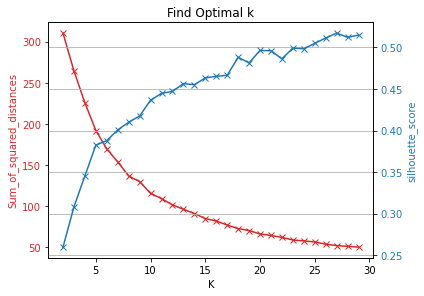

In [28]:
#plot results
K = range(2,30)
fig, ax1 = plt.subplots()
#fig.set_size_inches(18.5, 10.5)
color = 'tab:red'
ax1.set_xlabel('K')
ax1.set_ylabel('Sum_of_squared_distances', color=color)
ax1.plot(K, Sum_of_squared_distances, color=color, marker='x')
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax2.set_ylabel('silhouette_score', color=color)  # we already handled the x-label with ax1
ax2.plot(K, sil, color=color, marker='x')
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
plt.title('Find Optimal k')
plt.grid(True)
plt.show()

From above plot, silhouette score for K=20 is close to 0.5, and we will use this as the best clustering parameter.

In [29]:
k = 20
print("n=", n, ' k=', k, ', silhouette_score=', sil[20])

n= 65  k= 20 , silhouette_score= 0.48628318937133813


Run K-Means model for K=20

In [30]:
km = KMeans(n_clusters=k, random_state=0)
km = km.fit(grouped_clustering)

## IV Results

Now, we will map cluster labels to all restaurants and plot it on map.

In [31]:
grouped2 = grouped.copy()
grouped2.insert(0, 'Cluster Labels', km.labels_)
grouped2.head(2)

,Cluster Labels,Area,Afghan Restaurant,African Restaurant,American Restaurant,Asian Restaurant,Australian Restaurant,Cafe,Cajun / Creole Restaurant,Caribbean Restaurant,...,Pub,Restaurant,Scandinavian Restaurant,Seafood Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sri Lankan Restaurant,Swiss Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant
0,16,19,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,2,102,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [32]:
df2 = df.join(grouped2.set_index('Area'), on='square')
df2.head(2)

,area,area_lat,area_lng,id,name,lat,lng,category,distance,address,...,Pub,Restaurant,Scandinavian Restaurant,Seafood Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sri Lankan Restaurant,Swiss Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant
0,Area_0,29.654315,-95.501521,4c1e4415fcf8c9b671f3ac0b,Teotihuacan Mexican Cafe,29.655483,-95.506624,Mexican Restaurant,510,"6579 W Bellfort St (at Larkwood Dr.), Houston,...",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,Area_0,29.654315,-95.501521,4f32176c19836c91c7b4ef20,Las Delicias Taqueria,29.657900,-95.497726,Food,542,"11131 Albury Dr, Houston, TX 77096, United States",...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [33]:
df3 = df2[['lat','lng','Cluster Labels','name','category','square']]
df3.head(2)

,lat,lng,Cluster Labels,name,category,square
0,29.655483,-95.506624,9,Teotihuacan Mexican Cafe,Mexican Restaurant,1948
1,29.657900,-95.497726,3,Las Delicias Taqueria,Food,2015


In [34]:
import branca.colormap as cmp
linear = cmp.LinearColormap(
    ['black','gray','yellow','orange','green','blue','red', 'purple'],
    vmin=-1, vmax=21,
    caption='Cluster Labels' 
)
linear

As we can see, most popolar restarurants are located along highway 59 and 6. To have a better view about Asian resaturants in the whole, we'll group these restaurants based on cluster label and create a 10-most-common restaurants in each cluster.

In [35]:
center_lat = 29.6589382
center_lng = -95.7276974
map = folium.Map(location=[center_lat, center_lng],zoom_start=12)   
for lat,lng,name,area,cluster in zip(df3['lat'], df3['lng'], df3['name'],df3['square'],df3['Cluster Labels']):
    label = '{}-{}-{}'.format(cluster,area,name)
    label = folium.Popup(label, parse_html=True)
    if cluster >= -1:
        folium.CircleMarker(
            [lat,lng],
            radius = 2,
            popup = label,
            color= linear(cluster),
            fill = True,
            fill_color = linear(cluster),
            fill_opacity = 0.7,
            parse_html = False).add_to(map)
map.add_child(linear)  
map

In [36]:
onehot_new = pd.get_dummies(df3[['category']], prefix="", prefix_sep="")
onehot_new.insert(loc=0, column='Cluster Labels', value=df3['Cluster Labels'])
onehot_new.head(2)

,Cluster Labels,Afghan Restaurant,African Restaurant,American Restaurant,Asian Restaurant,Australian Restaurant,Cafe,Cajun / Creole Restaurant,Caribbean Restaurant,Comfort Food Restaurant,...,Pub,Restaurant,Scandinavian Restaurant,Seafood Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sri Lankan Restaurant,Swiss Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant
0,9,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [37]:
grouped_new = onehot_new.groupby('Cluster Labels').mean().reset_index()
grouped_new.head(2)

,Cluster Labels,Afghan Restaurant,African Restaurant,American Restaurant,Asian Restaurant,Australian Restaurant,Cafe,Cajun / Creole Restaurant,Caribbean Restaurant,Comfort Food Restaurant,...,Pub,Restaurant,Scandinavian Restaurant,Seafood Restaurant,Southern / Soul Food Restaurant,Spanish Restaurant,Sri Lankan Restaurant,Swiss Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant
0,0,0.0,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
1,1,0.0,0.008705,0.043526,0.284004,0.001088,0.063112,0.018498,0.005441,0.006529,...,0.004353,0.036997,0.001088,0.035909,0.002176,0.002176,0.001088,0.0,0.0,0.006529


In [38]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [39]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Cluster Labels']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
groupednew_sorted = pd.DataFrame(columns=columns)
groupednew_sorted['Cluster Labels'] = grouped_new['Cluster Labels']

for ind in np.arange(groupednew_sorted.shape[0]):
    groupednew_sorted.iloc[ind, 1:] = return_most_common_venues(grouped_new.iloc[ind, :], num_top_venues)

groupednew_sorted

,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,0,Cafe,Vegetarian / Vegan Restaurant,Eastern European Restaurant,Gluten-free Restaurant,German Restaurant,French Restaurant,Food,Fondue Restaurant,Fast Food Restaurant,Falafel Restaurant
1,1,Asian Restaurant,Fast Food Restaurant,Mexican Restaurant,Cafe,American Restaurant,Indian Restaurant,Restaurant,Seafood Restaurant,Latin American Restaurant,Cajun / Creole Restaurant
2,2,Fast Food Restaurant,Mexican Restaurant,Cafe,Pakistani Restaurant,American Restaurant,Indian Restaurant,Australian Restaurant,Restaurant,Eastern European Restaurant,French Restaurant
3,3,Food,Vegetarian / Vegan Restaurant,Halal Restaurant,Gluten-free Restaurant,German Restaurant,French Restaurant,Fondue Restaurant,Fast Food Restaurant,Falafel Restaurant,Eastern European Restaurant
4,4,Mexican Restaurant,Italian Restaurant,Asian Restaurant,Food,Fast Food Restaurant,Vegetarian / Vegan Restaurant,Eastern European Restaurant,German Restaurant,French Restaurant,Fondue Restaurant
5,5,American Restaurant,Fast Food Restaurant,Mexican Restaurant,Spanish Restaurant,Cafe,Restaurant,Greek Restaurant,Vegetarian / Vegan Restaurant,German Restaurant,French Restaurant
6,6,Indian Restaurant,Fast Food Restaurant,Middle Eastern Restaurant,Asian Restaurant,Cajun / Creole Restaurant,Restaurant,Pub,Vegetarian / Vegan Restaurant,French Restaurant,Food
7,7,Asian Restaurant,Fast Food Restaurant,Cajun / Creole Restaurant,Food,Cafe,American Restaurant,Seafood Restaurant,Restaurant,Dumpling Restaurant,Vegetarian / Vegan Restaurant
8,8,Cajun / Creole Restaurant,Asian Restaurant,Fast Food Restaurant,Vegetarian / Vegan Restaurant,Eastern European Restaurant,Gluten-free Restaurant,German Restaurant,French Restaurant,Food,Fondue Restaurant
9,9,Fast Food Restaurant,Asian Restaurant,Mexican Restaurant,Cafe,American Restaurant,Restaurant,Latin American Restaurant,Indian Restaurant,Seafood Restaurant,Italian Restaurant


In [40]:
groupednew_sorted.to_csv('./top_venues.csv', index=False)

As we can see, Asian restaurants are very popular in west Houston area, especially in cluster 1, 7(1st Most Common Vanue), 8 and 9(2nd Most Common Venue).

In [41]:
groupednew_sorted[groupednew_sorted['1st Most Common Venue']=='Asian Restaurant']

,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,1,Asian Restaurant,Fast Food Restaurant,Mexican Restaurant,Cafe,American Restaurant,Indian Restaurant,Restaurant,Seafood Restaurant,Latin American Restaurant,Cajun / Creole Restaurant
7,7,Asian Restaurant,Fast Food Restaurant,Cajun / Creole Restaurant,Food,Cafe,American Restaurant,Seafood Restaurant,Restaurant,Dumpling Restaurant,Vegetarian / Vegan Restaurant


In [42]:
groupednew_sorted[groupednew_sorted['2nd Most Common Venue']=='Asian Restaurant']

,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
8,8,Cajun / Creole Restaurant,Asian Restaurant,Fast Food Restaurant,Vegetarian / Vegan Restaurant,Eastern European Restaurant,Gluten-free Restaurant,German Restaurant,French Restaurant,Food,Fondue Restaurant
9,9,Fast Food Restaurant,Asian Restaurant,Mexican Restaurant,Cafe,American Restaurant,Restaurant,Latin American Restaurant,Indian Restaurant,Seafood Restaurant,Italian Restaurant


In [43]:
map = folium.Map(location=[center_lat, center_lng],zoom_start=11,height=500,width=500)   
for lat,lng,name,area,cluster in zip(df3['lat'], df3['lng'], df3['name'],df3['square'],df3['Cluster Labels']):
    label = '{}-{}-{}'.format(cluster,area,name)
    label = folium.Popup(label, parse_html=True)
    if cluster in [1,7,8,9]:
        folium.CircleMarker(
            [lat,lng],
            radius = 2,
            popup = label,
            color= linear(cluster),
            fill = True,
            fill_color = linear(cluster),
            fill_opacity = 0.7,
            parse_html = False).add_to(map)
map.add_child(linear)        
map

## V Discussion

Now, let's create bar chart and pie chart to explore cluster 1,7,8 and 9 respectively.

In [44]:
def generate_category_chart(cluster_id):
    data = []
    data_labels = []
    for row in groupednew_sorted:
        if groupednew_sorted.iloc[cluster_id][row] != cluster_id:
            category = groupednew_sorted.iloc[cluster_id][row]
            data_labels.append(category)
            data.append(grouped_new.iloc[cluster_id][category])
    x= [1,2,3,4,5,6,7,8,9,10]
    plt.bar(x, data, width=0.5)
    plt.xlabel("Most Common Venues")
    plt.ylabel("Percentage")

    fig1, ax1 = plt.subplots()
    ax1.pie(data, labels=data_labels, autopct='%1.1f%%',normalize=True, shadow=True, startangle=0)
    plt.title("10 Most Common Venues")
    plt.show()
    return
 
def generate_category_map(cluster_id):
    print("Cluster label = ", cluster_id)
    map = folium.Map(location=[center_lat, center_lng],zoom_start=11,height=500,width=500)   
    for lat,lng,name,area,cluster in zip(df3['lat'], df3['lng'], df3['name'],df3['square'],df3['Cluster Labels']):
        label = '{}-{}-{}'.format(cluster,area,name)
        label = folium.Popup(label, parse_html=True)
        if cluster == cluster_id:
            folium.CircleMarker(
                [lat,lng],
                radius = 2,
                popup = label,
                color= linear(cluster),
                fill = True,
                fill_color = linear(cluster),
                fill_opacity = 0.7,
                parse_html = False).add_to(map)
    map.add_child(linear)
    return map

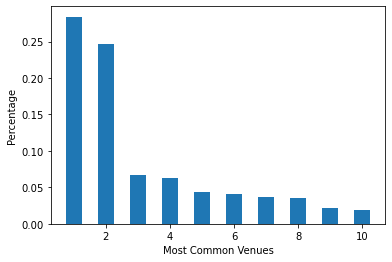

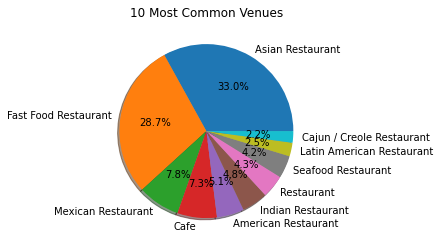

In [45]:
generate_category_chart(1)

In [46]:
generate_category_map(1)

Cluster label =  1


From above bar chart and map, it is clear that this category is the most common category with 33% Asian restaurants and 28.7% Fast food restaurant, and it's widely spreaded out in west houston. Most restaurants in Sugar Land are located near the intersection of Highway 59 and 6.

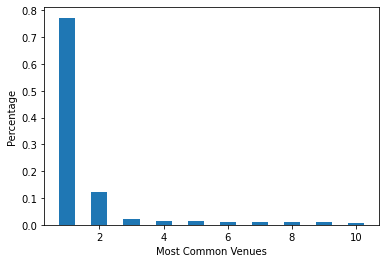

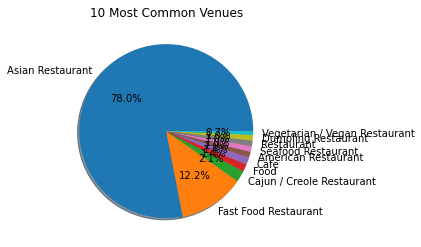

In [47]:
generate_category_chart(7)

In [48]:
generate_category_map(7)

Cluster label =  7


For category 7, 78% restaurants are Asian restaurants. These are hot spots for Asian food. Both Houston China town and Katy Asian town fall into this category. In Sugar Land, there are 5 Asian restaurants in the plaza near Hight 6 and Austin Parkway. This is probably the best location for future Asian restaurant with the best traffic.

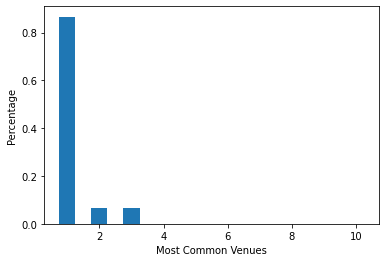

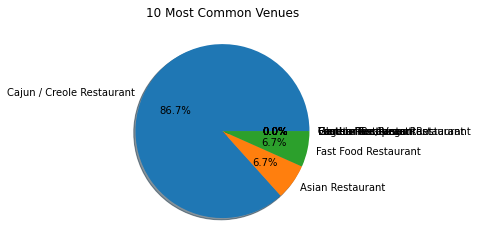

In [49]:
generate_category_chart(8)

Category 8 contains 6.7% Asian restaurants, but not many restaurants are observed from map. 

In [50]:
generate_category_map(8)

Cluster label =  8


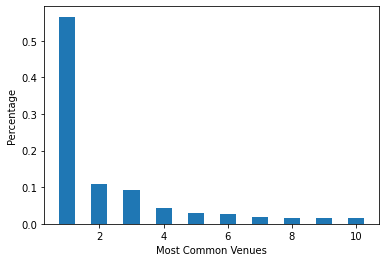

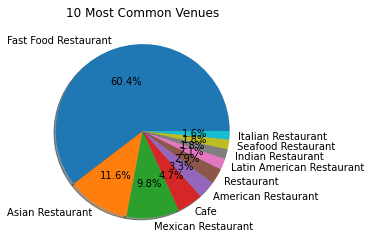

In [51]:
generate_category_chart(9)

In [52]:
generate_category_map(9)

Cluster label =  9


Category 9 is very popular also. There 60.4% Fast food restaurants and 11.6% Asian restaurants. All these restaurants are located along highway 6.

## VI Conclusion

For a new business, the most important factor is choosing a right place to start the business. This is more crucial and a very big challenge for restaurant business because there are some many restaurants in every city. This project tries to use data science algorithm (K-Means) to analyze current restaurant distribution in West Houston area, and find out potential locations for a new Asian restaurants in Sugar Land and Missouri City.

After analyzing all the clusters with Asian restaurants in 1st and 2 most-common-venues, and considering the percentage/number of restaurants in each cluster, cluster 1,7,and 9 seem to be the best clusters for a new Asian restaurant in Sugar Land/Missouri area. Most of restaurants in these clusters are opened along highway 59 and 6. Especially, cluster 7 has the highest percentage of Asian restaurants and also covers Houston China town, Katy Asian Town and a plaza with 5 Asian restaurants near Highway 6 and Austin Pkwy in Sugar Land. Therefore that plaza or a nearby location in Sugar Land might be a perfect place for opening a similar Asian restaurant as restaurants in Houston China town and Katy Asin Town.  Cluster 1 and 9 areas are also suitable for a new Asian restaurant business and more challenges will be expected with high percentage of fast-food restaurants.

## References

[1]	Sugar Land, Wikipedia https://en.wikipedia.org/wiki/Sugar_Land,_Texas

[2]	Missouri City, Wikipedia https://en.wikipedia.org/wiki/Missouri_City,_Texas

[3]	Foursquare Venue Category Hierarchy https://developer.foursquare.com/docs/build-with-foursquare/categories/

[4]	Selecting the number of clusters with silhouette analysis on KMeans clustering https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html


## Project Link in GitHub

CapestoneProject_PredictingLocationon_Report.doc 

CapestoneProject_PredictingLocationon_Presentation.pptx

CapestoneProject_PredictingLocation.ipynb